In [95]:
%pylab inline
%matplotlib inline

Populating the interactive namespace from numpy and matplotlib


In [96]:
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
import scipy as sc
import numpy as np
from time import time
import math
import itertools
from IPython.display import Audio
from sklearn.decomposition import MiniBatchDictionaryLearning
from sklearn.decomposition import SparseCoder
from scipy.io import wavfile

In [97]:
# import os
# os.chdir("/path/to/wav")
fs, data = wavfile.read("Bohemian_Rhapsody_16Khz_16bit_mono_cut.wav")

# http://samcarcagno.altervista.org/blog/basic-sound-processing-python/
# the sound pressure values are mapped to integer values that can range 
# from -2^15 to (2^15)-1. We can convert our sound array to floating point
# values ranging from -1 to 1 as follows:
data = data / 2.0**15
data_len = data.shape[0]

# Initialize reconstruction vector
recon = np.zeros(data_len)

print('Data size %s, frame rate %s' % (data.shape, fs))

Audio(rate = fs, data = data)

Data size (5680944,), frame rate 16000


(160, 1000)


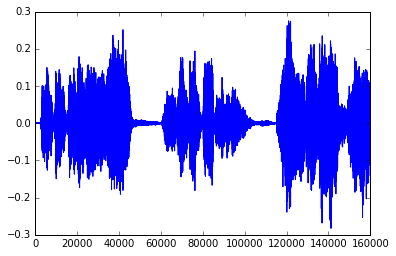

In [98]:
# set training parameters & extract sample
train_factor = 10
end_train = fs * train_factor

n_components = 500 #nb of atoms
n_features = 2*n_components
n_samples_training = int(end_train / n_features)

training_data_vec = data[0:end_train] #160,000 samples

# reshape the training data to an array (n_samples, n_features) = (160,1000)
training_data = training_data_vec.reshape(n_samples_training, n_features) 
print(training_data.shape)

# plot training set
plt.plot(training_data_vec)

# play training sample signal
Audio(rate = fs, data = training_data_vec)

In [104]:
# Build the initial dictionary

t0 = time()

# by default, fit with LARS and transform with OMP
# lambda_param = 1.2 / math.sqrt(m) #As per Mairal suggestion, p. 6

#Mairal:
#X is n samples (iid samples from unknown distribution) in m dimensions -- (m x n)
#D is (m x k)
# k << n
# k > m (overcomplete)
# So, for this signal:
#    * m is the sample audio length we choose to take - 32,000 samples
#    * n is the length of the audio signal data / m
#    * k is the num_components we choose to generate in the dictionary -
#------------------------------
# Input: samples X (n_samples, n_features = m) = (160,1000)
# Output: dictionary D of size (n_components = k, n_features = m) = (500,1000)

dico = MiniBatchDictionaryLearning(n_components = n_components,  
                                   alpha = 1,
                                   n_iter = 200,
                                   transform_algorithm='omp',
                                   transform_alpha = 0.001)

dico = dico.fit(training_data)
t1 = time() - t0

# Intel Core i5-5300U @ 2.30GHz, 20 GB RAM
# k = 1000: 901 seconds = 15 minutes to train
# k =  500: 93 seconds = 1.5 minutes to train
# k =  500, alpha = 1: 40 seconds to train

# Intel Core 2 Duo 2GHz, 4 GB RAM
# k = 500, alpha = 1: 97 seconds to train
print('Trained in %d seconds' % t1)

Trained in 92 seconds


In [105]:
#Reconstruct the training set with the initial dictionary
D = dico.components_
#coder = SparseCoder(dictionary = D, transform_alpha = 0.001, 
#                    transform_algorithm = 'omp')
#alpha = coder.transform(training_data) # (n_samples,n_components) = (160,500)
alpha = dico.transform(training_data)
out = np.matmul(alpha, D).flatten()
recon[0:end_train] = out

Audio(rate = fs, data = recon[0:end_train])

In [106]:
# Extract testing signal & set online learning parameters

testing_data_vec = data[end_train:data_len]

# window width in seconds
window_width = 2
window_samples = window_width * fs

# length of the test signal in seconds
sig_length = len(testing_data_vec) / fs

# calculate the number of windows
num_windows = int(sig_length / window_width)

# calculate n_samples
n_samples_learn = int(window_samples / n_features)

print(num_windows)

172


In [107]:
# Initialize output objects
sse = np.zeros(num_windows)
objective = np.zeros(num_windows)

In [ ]:
t0 = time()
offset = end_train
# for i in range(0, num_windows):
# loop from 0 to 99, i.e., the first 100 windows
for i in range(0, num_windows):
    # for now, the windows do not overlap
    start_idx = window_samples * i
    end_idx = window_samples * (i + 1)
    
    # extract window of data; window_width = 2, so 32,000 samples
    orig = testing_data_vec[start_idx:end_idx]
    
    # reshape the new data to an array of samples (32 x 1000)
    new_data = orig.reshape(n_samples_learn, n_features)
    
    #D is (500,1000)
    #coder = SparseCoder(dictionary = D, transform_alpha = 0.001, 
    #                    transform_algorithm = 'omp')
    
    # learn optimal reconstruction vector (32, 500)
    alpha = dico.transform(new_data)
    alpha_flat = alpha.flatten()
    
    # compute sparsity of alpha
    sparsity[i] = sum(alpha_flat == 0)
    
    # compute SSE
    out = np.matmul(alpha, D).flatten()
    sse_i = sum((out - orig)**2)
    sse[i] = sse_i
    objective[i] = 0.5*sse_i + sum(abs(alpha_flat))
    
    # append to the reconstruction
    recon[offset+start_idx:offset+end_idx] = out
    
    # update the dictionary
    dico = dico.partial_fit(new_data)
    D = dico.components_

t1 = time() - t0

# Intel Core i5-5300U @ 2.30GHz, 20 GB RAM
# process first 25 windows = 19 minutes
# process first 50 windows = 2361 seconds = 39 minutes
# process first 100 windows = 4670 seconds = 78 minutes

# Intel Core 2 Duo 2GHz, 4 GB RAM
# process first 5 windows = 514 seconds = 9 minutes
# process first 20 windows = 2203 seconds = 37 minutes

#-----------------------------------------------------------
# Intel(R) Xeon(R) CPU E5-2620 0 @ 2.00GHz, 96 GB RAM
# process first 5 windows = 4.5 min
# process first 25 windows = 23 min
print('Finished in %d seconds' % t1)
    
#print(sse)

In [112]:
print(sse[0:7])
print(sparsity[0:7])
print(objective[0:7])
output_data = np.vstack([sse, sparsity])
#np.savetxt('/mnt/raid6/dss/data/managed_folders/ONLINEDICTIONARYLEARNING/tpvpBtPq/sse_and_sparsity.csv', output_data.T, delimiter=",")

[ 48.58064709  81.49617141  41.56689629  59.01228644  52.14468238
  51.99426192  58.30143042]
[ 12800.  12800.  12800.  12800.  12800.  12800.  12800.]
[ 290.60834339  383.21338653  258.06119525  331.70926559  322.02613106
  304.24836058  351.52926058]


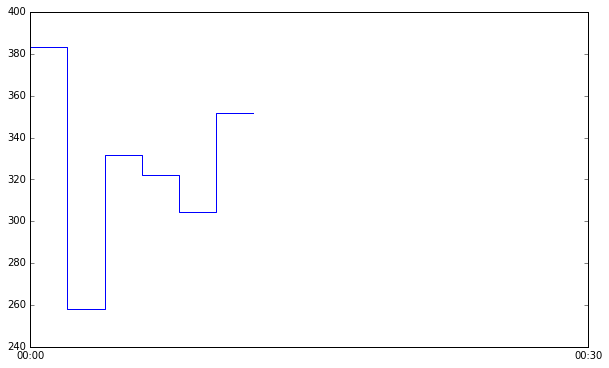

In [114]:
# plot the SSE step function for 2-second windows
x = np.multiply(2, list(range(sse[0:7].shape[0])))
#t = np.multiply(0.03333333333, list(range(sse[0:num_windows].shape[0])))

locator = mticker.MultipleLocator(30)
formatter = mticker.FuncFormatter(lambda x, y: '%02d:%02d' % divmod(x, 60))
fig = plt.figure()
ax = plt.gca()
fig.set_size_inches(10, 6)
ax.xaxis.set_major_locator(locator)
ax.xaxis.set_major_formatter(formatter)
plt.step(x, objective[0:7])
#savefig('/mnt/raid6/dss/data/managed_folders/ONLINEDICTIONARYLEARNING/tpvpBtPq/sse_time.eps', format='eps', dpi=1000)

In [73]:
#wavfile.write("/mnt/raid6/dss/data/managed_folders/ONLINEDICTIONARYLEARNING/tpvpBtPq/recon.wav", 16000, recon)

In [30]:
# play the reconstructed signal
Audio(data = recon, rate = fs)

In [67]:
matplotlib.get_backend()

'module://ipykernel.pylab.backend_inline'